## 1) Initial Imports and loading the utils function. The dataset is used is <a href='https://www.kaggle.com/adityajn105/flickr8k'>Flickr 8k</a> from kaggle.


In [1]:
#imports 
import os
from collections import Counter
import spacy
import torch
from torch.nn.utils.rnn import pad_sequence
from torch.utils.data import DataLoader,Dataset
import torchvision.transforms as T
import pandas as pd
from tqdm import tqdm
from PIL import Image
import torch.optim.lr_scheduler as lr_scheduler
import numpy as np
import matplotlib.pyplot as plt
from textwrap import wrap
from sklearn.feature_extraction.text import CountVectorizer
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from wordcloud import WordCloud


## 2) Exploratory Data Analysis


In [2]:
# Load data
data = pd.read_csv("../input/flickr8k/captions.txt")
image_path = '../input/flickr8k/Images'

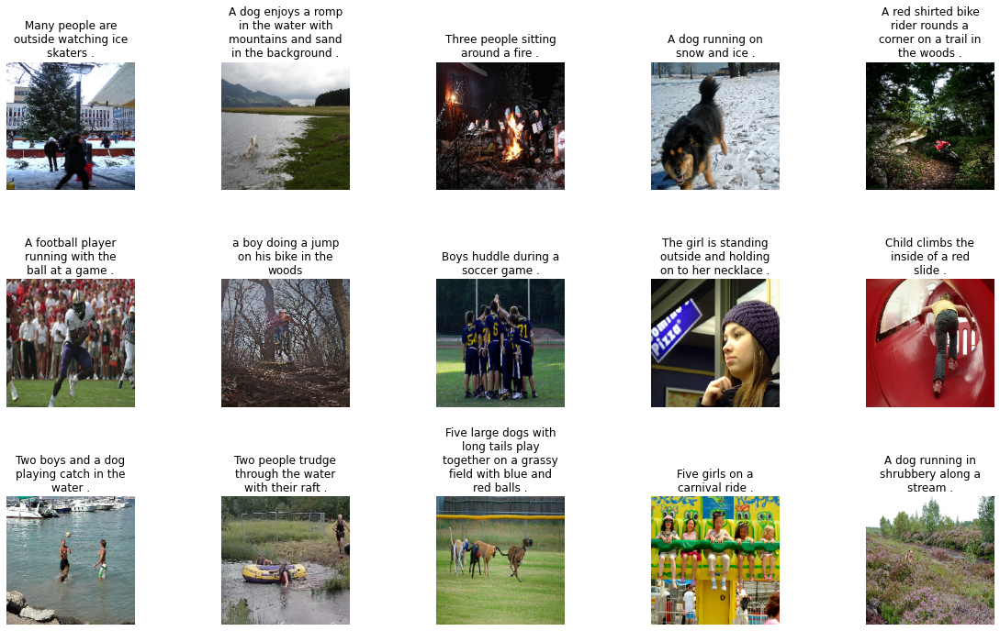

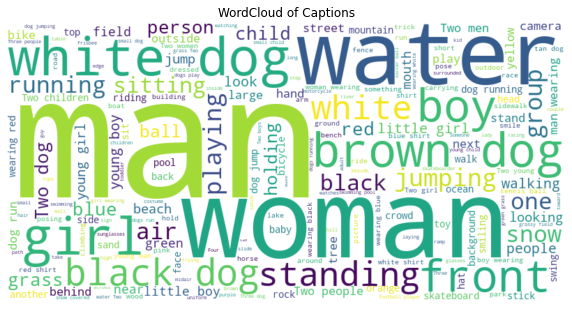

Statistical Analysis of Captions:
Mean Caption Length: 11.78 words
Maximum Caption Length: 38 words
Minimum Caption Length: 1 words


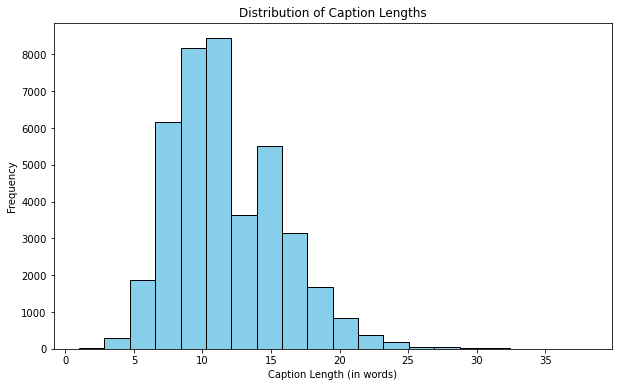

In [3]:


# Function to read images
def read_image(path, img_size=224):
    img = load_img(path, color_mode='rgb', target_size=(img_size, img_size))
    img = img_to_array(img)
    img = img / 255.

    return img

# Function to display images
def display_images(temp_df, save_fig=False):
    temp_df = temp_df.reset_index(drop=True)
    plt.figure(figsize=(20, 20))
    n = 0
    for i in range(15):
        n += 1
        plt.subplot(5, 5, n)
        plt.subplots_adjust(hspace=0.7, wspace=0.3)
        image = read_image(f"{image_path}/{temp_df.image[i]}")
        plt.imshow(image)
        plt.title("\n".join(wrap(temp_df.caption[i], 20)))
        plt.axis("off")

    if save_fig:
        plt.savefig('sample_images.png')
    else:
        plt.show()

# Display and save sample images
display_images(data.sample(15), save_fig=True)

# Bag-of-Words representation
vectorizer = CountVectorizer()
captions_bow = vectorizer.fit_transform(data['caption'])

# WordCloud
wordcloud = WordCloud(width=800, height=400, background_color='white').generate(' '.join(data['caption']))

plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('WordCloud of Captions')

# Save the WordCloud figure
plt.savefig('wordcloud.png')
plt.show()

# Statistical analysis of captions
captions_length = data['caption'].apply(lambda x: len(x.split()))
mean_length = np.mean(captions_length)
max_length = np.max(captions_length)
min_length = np.min(captions_length)

print("Statistical Analysis of Captions:")
print(f"Mean Caption Length: {mean_length:.2f} words")
print(f"Maximum Caption Length: {max_length} words")
print(f"Minimum Caption Length: {min_length} words")

# Plot histogram of caption lengths
plt.figure(figsize=(10, 6))
plt.hist(captions_length, bins=20, color='skyblue', edgecolor='black')
plt.title('Distribution of Caption Lengths')
plt.xlabel('Caption Length (in words)')
plt.ylabel('Frequency')

# Save the histogram figure
plt.savefig('caption_length_histogram.png')
plt.show()


In [4]:
#using spacy for the better text tokenization 
spacy_eng = spacy.load("en")

#example
text = "This is a good place to find a city"
[token.text.lower() for token in spacy_eng.tokenizer(text)]

['this', 'is', 'a', 'good', 'place', 'to', 'find', 'a', 'city']

## 3) Data Preprocessing


In [5]:
class Vocabulary:
    def __init__(self,freq_threshold):
        #setting the pre-reserved tokens int to string tokens
        self.itos = {0:"<PAD>",1:"<SOS>",2:"<EOS>",3:"<UNK>"}
        
        #string to int tokens
        #its reverse dict self.itos
        self.stoi = {v:k for k,v in self.itos.items()}
        
        self.freq_threshold = freq_threshold
        
    def __len__(self): return len(self.itos)
    
    @staticmethod
    def tokenize(text):
        return [token.text.lower() for token in spacy_eng.tokenizer(text)]
    
    def build_vocab(self, sentence_list):
        frequencies = Counter()
        idx = 4
        
        for sentence in sentence_list:
            for word in self.tokenize(sentence):
                frequencies[word] += 1
                
                #add the word to the vocab if it reaches minum frequecy threshold
                if frequencies[word] == self.freq_threshold:
                    self.stoi[word] = idx
                    self.itos[idx] = word
                    idx += 1
    
    def numericalize(self,text):
        """ For each word in the text corresponding index token for that word form the vocab built as list """
        tokenized_text = self.tokenize(text)
        return [ self.stoi[token] if token in self.stoi else self.stoi["<UNK>"] for token in tokenized_text ]    

In [6]:
class FlickrDataset(Dataset):
    """
    FlickrDataset
    """
    def __init__(self,root_dir,captions_file,transform=None,freq_threshold=5):
        self.root_dir = root_dir
        self.df = pd.read_csv(captions_file)
        self.transform = transform
        
        #Get image and caption colum from the dataframe
        self.imgs = self.df["image"]
        self.captions = self.df["caption"]
        
        #Initialize vocabulary and build vocab
        self.vocab = Vocabulary(freq_threshold)
        self.vocab.build_vocab(self.captions.tolist())
        
    
    def __len__(self):
        return len(self.df)
    
    def __getitem__(self,idx):
        caption = self.captions[idx]
        img_name = self.imgs[idx]
        img_location = os.path.join(self.root_dir,img_name)
        img = Image.open(img_location).convert("RGB")
        
        #apply the transfromation to the image
        if self.transform is not None:
            img = self.transform(img)
        
        #numericalize the caption text
        caption_vec = []
        caption_vec += [self.vocab.stoi["<SOS>"]]
        caption_vec += self.vocab.numericalize(caption)
        caption_vec += [self.vocab.stoi["<EOS>"]]
        
        return img, torch.tensor(caption_vec),caption

In [7]:
class CapsCollate:
    """
    Collate to apply the padding to the captions with dataloader
    """
    def __init__(self,pad_idx,batch_first=False):
        self.pad_idx = pad_idx
        self.batch_first = batch_first
    
    def __call__(self,batch):
        imgs = [item[0].unsqueeze(0) for item in batch]
        imgs = torch.cat(imgs,dim=0)
        
        targets = [item[1] for item in batch]
        targets = pad_sequence(targets, batch_first=self.batch_first, padding_value=self.pad_idx)
        caps = [item[2] for item in batch]
        return imgs,targets,caps

In [8]:

data_location =  "../input/flickr8k"

#imports
import numpy as np
import torch
from torch.utils.data import DataLoader,Dataset
import torchvision.transforms as T


In [9]:
#show the tensor image
import matplotlib.pyplot as plt
def show_image(img, title=None):
    """Imshow for Tensor."""
    
    #unnormalize 
    img[0] = img[0] * 0.229
    img[1] = img[1] * 0.224 
    img[2] = img[2] * 0.225 
    img[0] += 0.485 
    img[1] += 0.456 
    img[2] += 0.406
    
    img = img.numpy().transpose((1, 2, 0))
    
    
    plt.imshow(img)
    if title is not None:
        plt.title(title)
    plt.pause(0.001)  # pause a bit so that plots are updated

## **<b>Implementing the Dataloaders**

In [10]:
#Initiate the Dataset and Dataloader

#setting the constants
data_location =  "../input/flickr8k"
BATCH_SIZE = 256
# BATCH_SIZE = 6
NUM_WORKER = 4

#defining the transform to be applied
transforms = T.Compose([
    T.Resize(224),                     
    T.RandomCrop(224),                 
    T.ToTensor(),                               
    T.Normalize((0.485, 0.456, 0.406),(0.229, 0.224, 0.225))
])


#testing the dataset class
dataset =  FlickrDataset(
    root_dir = data_location+"/Images",
    captions_file = data_location+"/captions.txt",
    transform=transforms
)

pad_idx = dataset.vocab.stoi["<PAD>"]


#vocab_size
vocab_size = len(dataset.vocab)

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
device

device(type='cuda', index=0)

In [35]:
from torch.utils.data import Subset


total_samples = len(dataset)


train_indices = range(0, int(0.75 * total_samples))  # 75% for training
val_indices = range(int(0.75 * total_samples), int(0.95*total_samples))  # 20% for validation
inf_indices = range(int(0.95* total_samples), total_samples) # 5% for inference



train_dataset = Subset(dataset, train_indices)
val_dataset = Subset(dataset, val_indices)
inf_dataset = Subset(dataset, inf_indices)




train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE,num_workers=NUM_WORKER, shuffle=True,collate_fn=CapsCollate(pad_idx=pad_idx,batch_first=True))

val_loader = DataLoader(val_dataset, batch_size=int(BATCH_SIZE/2),num_workers=NUM_WORKER, shuffle=True,collate_fn=CapsCollate(pad_idx=pad_idx,batch_first=True))

inf_loader = DataLoader(inf_dataset, batch_size=1,num_workers=NUM_WORKER, shuffle=False,collate_fn=CapsCollate(pad_idx=pad_idx,batch_first=True))



1
2
3
4


## 4) Defining the Model Architecture

Model is seq2seq model. In the **encoder** pretrained ResNet model is used to extract the features. Decoder, is the implementation of the Bahdanau Attention Decoder. In the decoder model **LSTM cell**.

In [11]:
import torch
import numpy as np
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim

import torchvision.models as models
from torch.utils.data import DataLoader,Dataset
import torchvision.transforms as T

In [12]:
class EncoderCNN(nn.Module):
    def __init__(self):
        super(EncoderCNN, self).__init__()
        resnet = models.resnet50(pretrained=True)
        for param in resnet.parameters():
            param.requires_grad_(False)
        
        modules = list(resnet.children())[:-2]
        self.resnet = nn.Sequential(*modules)
        

    def forward(self, images):
        features = self.resnet(images)                                    #(batch_size,2048,7,7)
        features = features.permute(0, 2, 3, 1)                           #(batch_size,7,7,2048)
        features = features.view(features.size(0), -1, features.size(-1)) #(batch_size,49,2048)
        return features


In [13]:
#Bahdanau Attention
class Attention(nn.Module):
    def __init__(self, encoder_dim,decoder_dim,attention_dim):
        super(Attention, self).__init__()
        
        self.attention_dim = attention_dim
        
        self.W = nn.Linear(decoder_dim,attention_dim)
        self.U = nn.Linear(encoder_dim,attention_dim)
        
        self.A = nn.Linear(attention_dim,1)
        
        
        
        
    def forward(self, features, hidden_state):
        u_hs = self.U(features)     #(batch_size,num_layers,attention_dim)
        w_ah = self.W(hidden_state) #(batch_size,attention_dim)
        
        combined_states = torch.tanh(u_hs + w_ah.unsqueeze(1)) #(batch_size,num_layers,attemtion_dim)
        
        attention_scores = self.A(combined_states)         #(batch_size,num_layers,1)
        attention_scores = attention_scores.squeeze(2)     #(batch_size,num_layers)
        
        
        alpha = F.softmax(attention_scores,dim=1)          #(batch_size,num_layers)
        
        attention_weights = features * alpha.unsqueeze(2)  #(batch_size,num_layers,features_dim)
        attention_weights = attention_weights.sum(dim=1)   #(batch_size,num_layers)
        
        return alpha,attention_weights
        

In [14]:
#Attention Decoder
class DecoderRNN(nn.Module):
    def __init__(self,embed_size, vocab, attention_dim,encoder_dim,decoder_dim,drop_prob=0.3):
        super().__init__()
        
        #save the model param
        self.vocab = vocab
        self.vocab_size = len(vocab)
        self.attention_dim = attention_dim
        self.decoder_dim = decoder_dim
        
        self.embedding = nn.Embedding(vocab_size,embed_size)
        self.attention = Attention(encoder_dim,decoder_dim,attention_dim)
        
        
        self.init_h = nn.Linear(encoder_dim, decoder_dim)  
        self.init_c = nn.Linear(encoder_dim, decoder_dim)  
        self.lstm_cell = nn.LSTMCell(embed_size+encoder_dim,decoder_dim,bias=True)
        self.f_beta = nn.Linear(decoder_dim, encoder_dim)
        
        
        self.fcn = nn.Linear(decoder_dim,vocab_size)
        self.drop = nn.Dropout(drop_prob)
        
        
    
    def forward(self, features, captions):
        
        #vectorize the caption
        embeds = self.embedding(captions)
        
        # Initialize LSTM state
        h, c = self.init_hidden_state(features)  # (batch_size, decoder_dim)
        
        #get the seq length to iterate
        seq_length = len(captions[0])-1 #Exclude the last one
        batch_size = captions.size(0)
        num_features = features.size(1)
        
        preds = torch.zeros(batch_size, seq_length, self.vocab_size).to(device)
        alphas = torch.zeros(batch_size, seq_length,num_features).to(device)
                
        for s in range(seq_length):
            alpha,context = self.attention(features, h)
            lstm_input = torch.cat((embeds[:, s], context), dim=1)
            h, c = self.lstm_cell(lstm_input, (h, c))
                    
            output = self.fcn(self.drop(h))
            
            preds[:,s] = output
            alphas[:,s] = alpha  
        
        
        return preds, alphas
    
    def generate_caption(self,features,max_len=20):
        # Inference part
        # Given the image features generate the captions
        
        batch_size = features.size(0)
        h, c = self.init_hidden_state(features)  # (batch_size, decoder_dim)
        
        alphas = []
        
        #starting input
        word = torch.tensor(self.vocab.stoi['<SOS>']).view(1,-1).to(device)
        embeds = self.embedding(word)

        
        captions = []
        
        for i in range(max_len):
            alpha,context = self.attention(features, h)
            
            
            #store the apla score
            alphas.append(alpha.cpu().detach().numpy())
            
            lstm_input = torch.cat((embeds[:, 0], context), dim=1)
            h, c = self.lstm_cell(lstm_input, (h, c))
            output = self.fcn(self.drop(h))
            output = output.view(batch_size,-1)
        
            
            #select the word with most val
            predicted_word_idx = output.argmax(dim=1)
            
            #save the generated word
            captions.append(predicted_word_idx.item())
            
            #end if <EOS detected>
            if self.vocab.itos[predicted_word_idx.item()] == "<EOS>":
                break
            
            #send generated word as the next caption
            embeds = self.embedding(predicted_word_idx.unsqueeze(0))
        
        #covert the vocab idx to words and return sentence
        return [self.vocab.itos[idx] for idx in captions],alphas
    
    
    def init_hidden_state(self, encoder_out):
        mean_encoder_out = encoder_out.mean(dim=1)
        h = self.init_h(mean_encoder_out)  # (batch_size, decoder_dim)
        c = self.init_c(mean_encoder_out)
        return h, c


In [15]:
class EncoderDecoder(nn.Module):
    def __init__(self,embed_size, vocab, attention_dim,encoder_dim,decoder_dim,drop_prob=0.3):
        super().__init__()
        self.encoder = EncoderCNN()
        self.decoder = DecoderRNN(
            embed_size=embed_size,
            vocab = dataset.vocab,
            attention_dim=attention_dim,
            encoder_dim=encoder_dim,
            decoder_dim=decoder_dim
        )
        
    def forward(self, images, captions):
        features = self.encoder(images)
        outputs = self.decoder(features, captions)
        return outputs


In [16]:
#helper function to save the model
def save_model(model,num_epochs):
    model_state = {
        'num_epochs':num_epochs,
        'embed_size':embed_size,
        'vocab_size':len(dataset.vocab),
        'attention_dim':attention_dim,
        'encoder_dim':encoder_dim,
        'decoder_dim':decoder_dim,
        'state_dict':model.state_dict()
    }

    torch.save(model_state,'attention_model_state.pth')

## Hyperparameters and model instanciation

In [36]:
#Hyperparams
embed_size=300
vocab_size = len(dataset.vocab)
attention_dim=256
encoder_dim=2048
decoder_dim=512
learning_rate = 5e-4
num_epochs = 25

#init model
model = EncoderDecoder(
    embed_size=embed_size,
    vocab = dataset.vocab,
    attention_dim=attention_dim,
    encoder_dim=encoder_dim,
    decoder_dim=decoder_dim
).to(device)

criterion = nn.CrossEntropyLoss(ignore_index=dataset.vocab.stoi["<PAD>"])
optimizer = optim.Adam(model.parameters(), lr=learning_rate)
#scheduler = lr_scheduler.CosineAnnealingLR(optimizer, T_max=num_epochs)


## 5) Training

In [39]:
import matplotlib.pyplot as plt
from nltk.translate.bleu_score import corpus_bleu
from torch.utils.tensorboard import SummaryWriter
def train_val_fn(model, train_loader, val_loader, optimizer , criterion, num_epochs, N, device,display=True):
    model.to(device)
    best_val_loss = float('inf')
    best_model=[]
    train_losses=[]
    val_losses=[]
    train_bleu_scores=[]
    val_bleu_scores=[]
    writer = SummaryWriter()
    
    for epoch in tqdm(range(1, num_epochs+1), desc="Training Epochs"):
        model.train()
        running_loss = 0.0
        total_batches = len(train_loader)

        for idx, (image, captions,reference) in enumerate(train_loader):
            image, captions = image.to(device), captions.to(device)
            
            optimizer.zero_grad()
            
            # Forward pass
            outputs, attentions = model(image, captions)
            
            # Calculate the batch loss
            targets = captions[:, 1:]
            loss = criterion(outputs.view(-1, vocab_size), targets.reshape(-1))
            
            # Backward pass
            loss.backward()
            
            # Update the parameters in the optimizer
            optimizer.step()
            
            running_loss += loss.item()
        
        epoch_loss = running_loss / total_batches

        # Validation
        model.eval()
        val_loss = 0.0
        with torch.no_grad():
            for val_image, val_captions,val_reference in val_loader:
                val_image,val_captions = val_image.to(device), val_captions.to(device)

                # Forward pass
                val_outputs, val_attentions = model(val_image, val_captions)

                # Calculate the validation loss
                val_targets = val_captions[:, 1:]
                val_loss += criterion(val_outputs.view(-1, vocab_size), val_targets.reshape(-1)).item()


        val_loss /= len(val_loader)
        
        if val_loss < best_val_loss:
            best_val_loss = val_loss
            best_model=model
            save_model(model, epoch)
        
        if display:
            print("Epoch: {}  Train_Loss: {:.5f} Val_Loss: {:.5f}".format(epoch, epoch_loss, val_loss))
            train_losses.append(epoch_loss)
            val_losses.append(val_loss)
            writer.add_scalar("Loss/Train", epoch_loss, epoch)
            writer.add_scalar("Loss/Val", val_loss, epoch)
            train_bleu_avg=0
            val_bleu_avg=0
            # Generate captions and calculate BLEU score
            model.eval()
            print("Train visualization: ")
            for i in range(N):
                with torch.no_grad():
                    dataiter = iter(train_loader)
                    img, _,reference = next(dataiter)
                    features = model.encoder(img[0:1].to(device))
                    caps, alphas = model.decoder.generate_caption(features)
                    reference=[reference[0:1][0].split(" ")]
                    train_bleu = corpus_bleu([reference], [caps])
                    # Visualization code if needed (you can modify this part)
                    caption = ' '.join(caps)
                    show_image(img[0], title=caption)
                train_bleu_avg+=train_bleu/N
            print("Val visualization: ")
            for i in range(N):
                with torch.no_grad():
                    dataiter = iter(val_loader)
                    img, _,reference = next(dataiter)
                    features = model.encoder(img[0:1].to(device))
                    caps, alphas = model.decoder.generate_caption(features)
                    reference=[reference[0:1][0].split(" ")]
                    val_bleu = corpus_bleu([reference], [caps])
                    # Visualization code if needed (you can modify this part)
                    caption = ' '.join(caps)
                    show_image(img[0], title=caption)
                val_bleu_avg+=val_bleu/N
            
            train_bleu_scores.append(train_bleu_avg)
            val_bleu_scores.append(val_bleu_avg)
            writer.add_scalar("BLEU/Train", train_bleu_avg, epoch)
            writer.add_scalar("BLEU/Val", val_bleu_avg, epoch)

        
    # Plot the loss curve
    plt.plot(train_losses, label='Training Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()
    plt.savefig('training_loss.png')
    plt.show()

    # Plot the BLEU score curve
    plt.plot(train_bleu_scores, label='Training BLEU Score')
    plt.xlabel('Epoch')
    plt.ylabel('BLEU Score')
    plt.legend()
    plt.savefig('training_bleu_score.png')
    plt.show()
    
    # Plot the loss curve
    plt.plot(val_losses, label='Val Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()
    plt.savefig('val_loss.png')
    plt.show()

    # Plot the BLEU score curve
    plt.plot(val_bleu_scores, label='Val BLEU Score')
    plt.xlabel('Epoch')
    plt.ylabel('BLEU Score')
    plt.legend()
    plt.savefig('val_bleu_score.png')
    plt.show()

    
    plt.plot(train_bleu_scores, label='Training BLEU Score')
    plt.plot(val_bleu_scores, label='Validation BLEU Score')
    plt.xlabel('Epoch')
    plt.ylabel('BLEU Score')
    plt.legend()
    plt.savefig('bleu_score_curves.png')
    plt.show()

    plt.plot(train_losses, label='Training Loss')
    plt.plot(val_losses, label='Validation Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()
    plt.savefig('loss_curves.png')
    plt.show()
    # Close the SummaryWriter
    writer.close()

    return best_model
        
            
            


Training Epochs:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch: 1  Train_Loss: 3.62494 Val_Loss: 3.42647
Train visualization: 


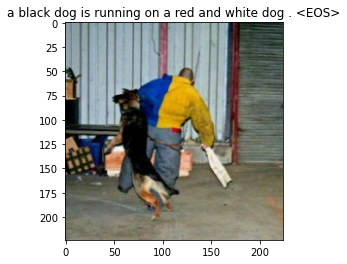

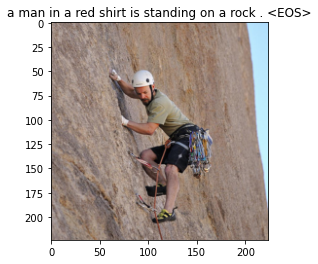

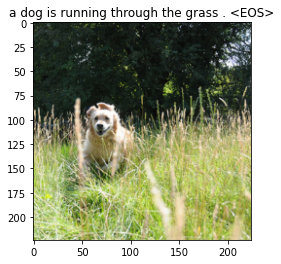

Val visualization: 


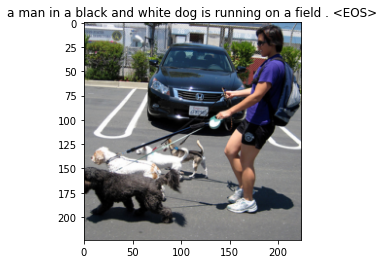

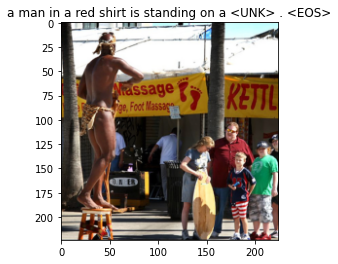

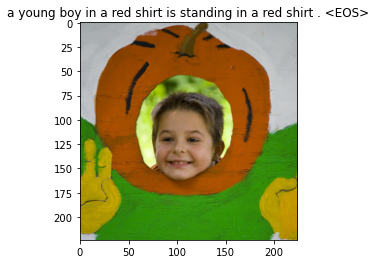

Training Epochs:   4%|▍         | 1/25 [03:16<1:18:37, 196.54s/it]

Epoch: 2  Train_Loss: 3.25772 Val_Loss: 3.19743
Train visualization: 


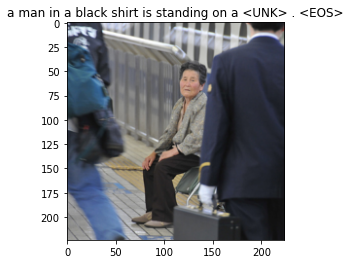

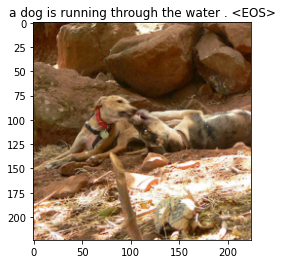

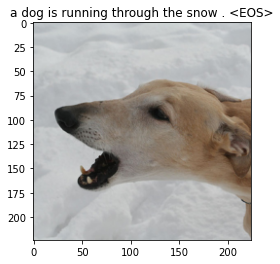

Val visualization: 


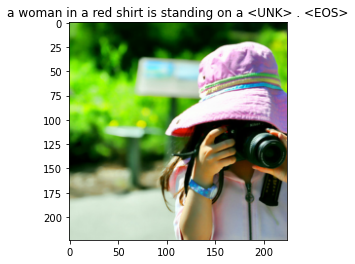

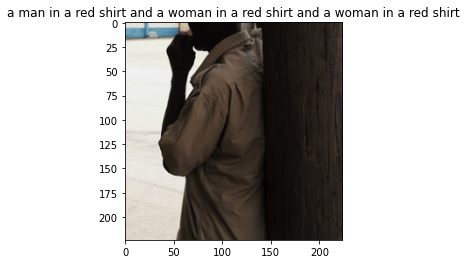

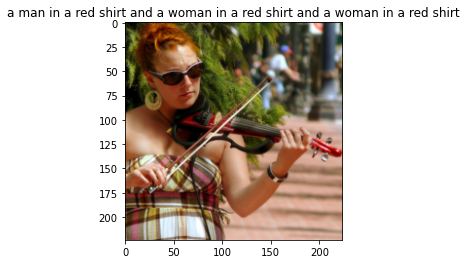

Training Epochs:   8%|▊         | 2/25 [06:34<1:15:30, 196.99s/it]

Epoch: 3  Train_Loss: 3.04204 Val_Loss: 3.05336
Train visualization: 


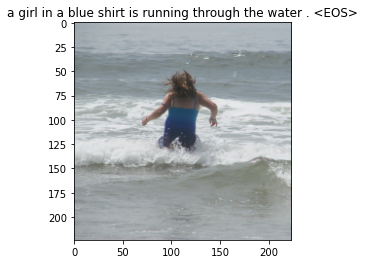

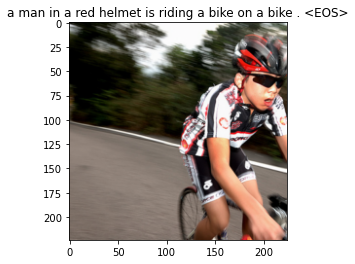

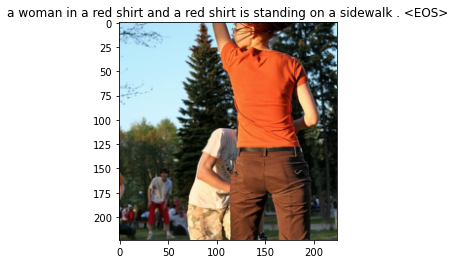

Val visualization: 


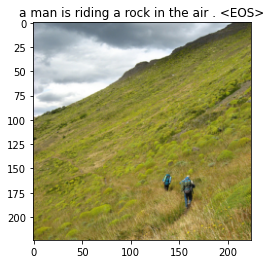

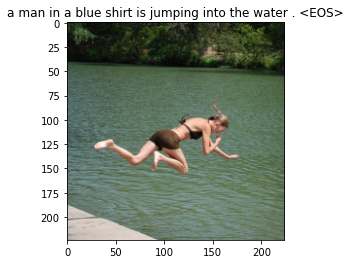

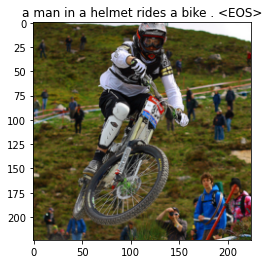

Training Epochs:  12%|█▏        | 3/25 [09:55<1:12:38, 198.10s/it]

Epoch: 4  Train_Loss: 2.89301 Val_Loss: 2.95851
Train visualization: 


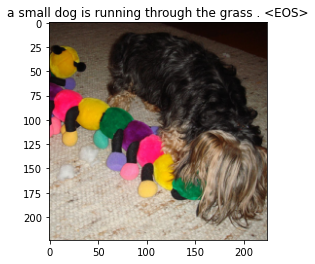

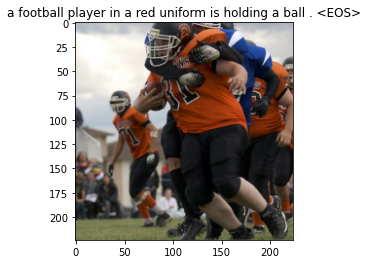

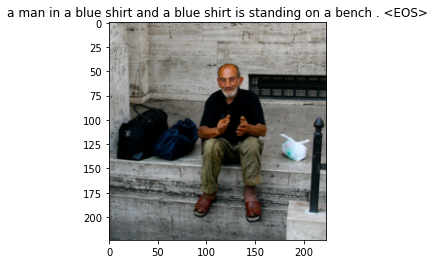

Val visualization: 


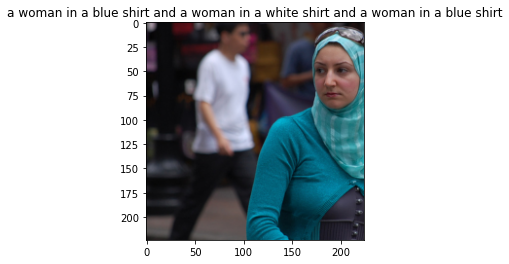

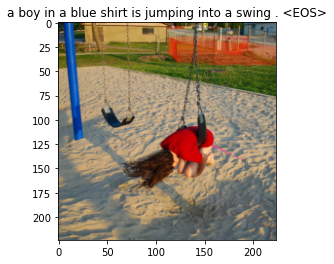

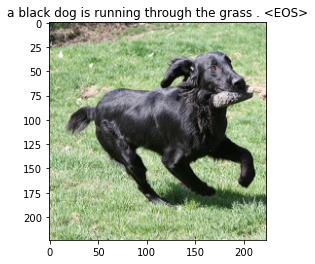

Training Epochs:  16%|█▌        | 4/25 [13:15<1:09:32, 198.70s/it]

Epoch: 5  Train_Loss: 2.77882 Val_Loss: 2.88588
Train visualization: 


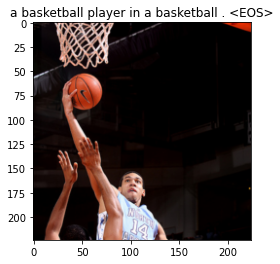

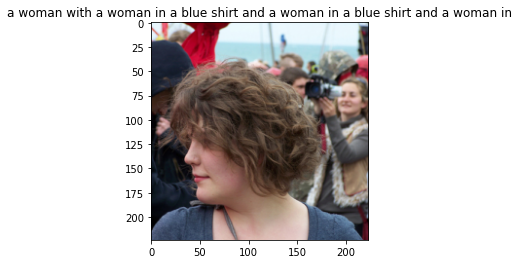

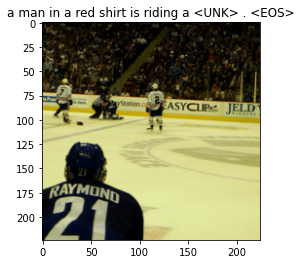

Val visualization: 


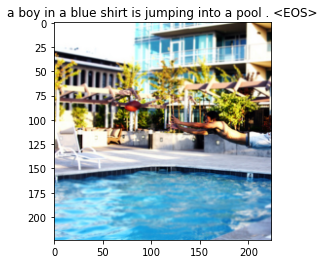

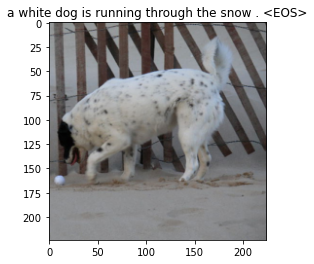

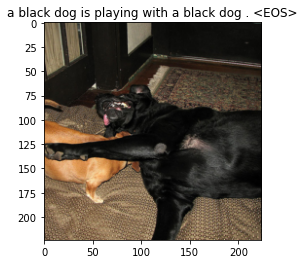

Training Epochs:  20%|██        | 5/25 [16:34<1:06:14, 198.71s/it]

Epoch: 6  Train_Loss: 2.68727 Val_Loss: 2.83799
Train visualization: 


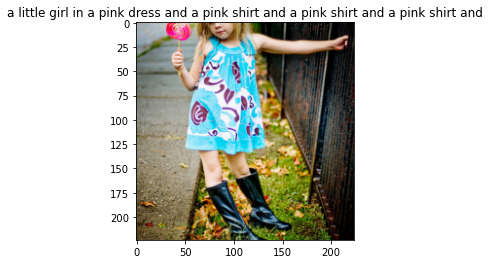

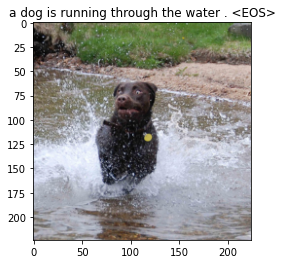

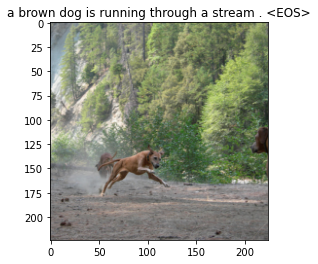

Val visualization: 


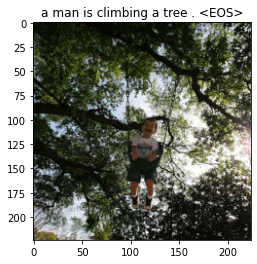

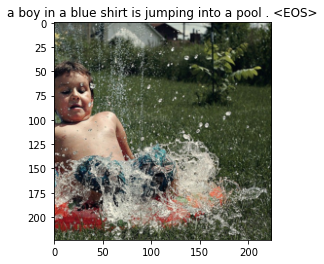

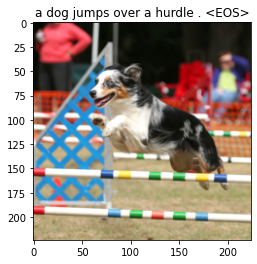

Training Epochs:  24%|██▍       | 6/25 [19:52<1:02:55, 198.72s/it]

Epoch: 7  Train_Loss: 2.61087 Val_Loss: 2.79426
Train visualization: 


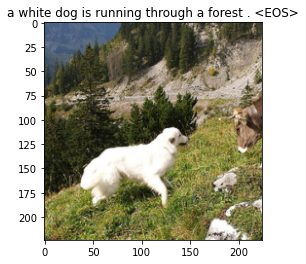

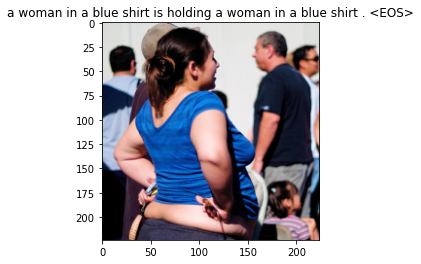

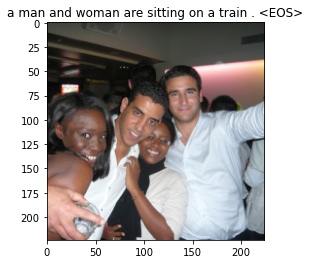

Val visualization: 


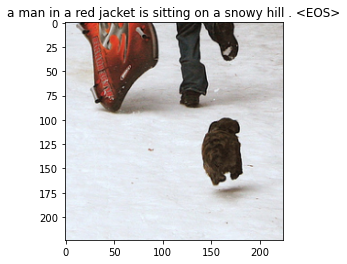

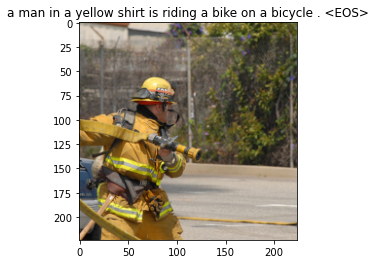

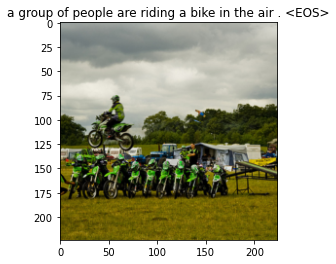

Training Epochs:  28%|██▊       | 7/25 [23:13<59:45, 199.17s/it]  

Epoch: 8  Train_Loss: 2.54367 Val_Loss: 2.76103
Train visualization: 


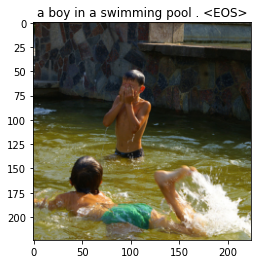

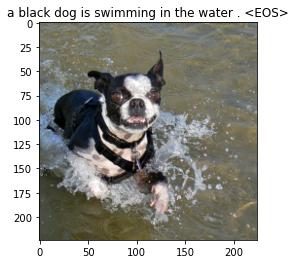

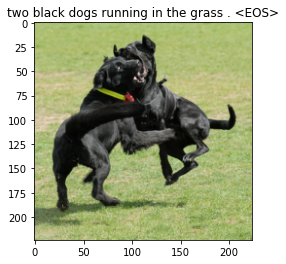

Val visualization: 


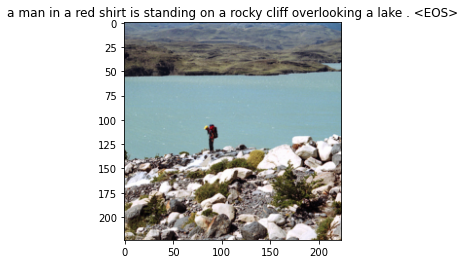

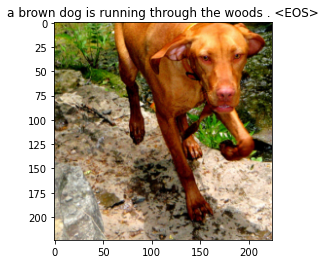

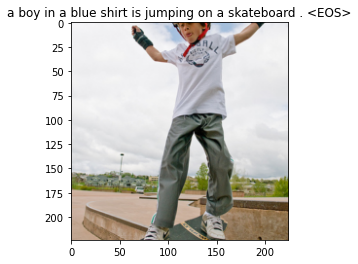

Training Epochs:  32%|███▏      | 8/25 [26:31<56:22, 198.99s/it]

Epoch: 9  Train_Loss: 2.48385 Val_Loss: 2.73552
Train visualization: 


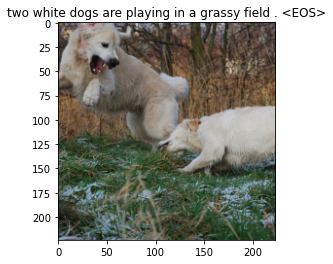

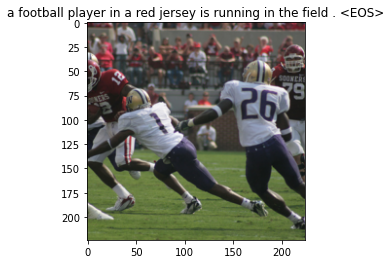

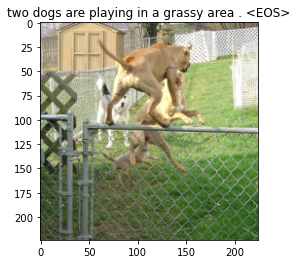

Val visualization: 


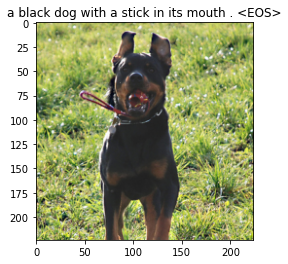

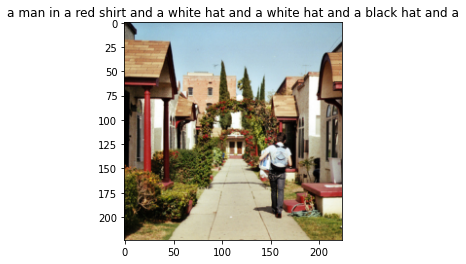

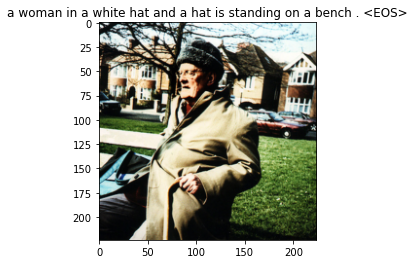

Training Epochs:  36%|███▌      | 9/25 [29:49<52:56, 198.55s/it]

Epoch: 10  Train_Loss: 2.42808 Val_Loss: 2.71183
Train visualization: 


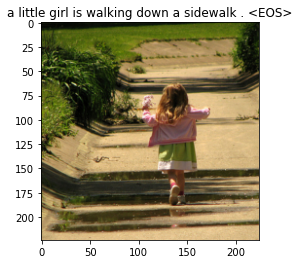

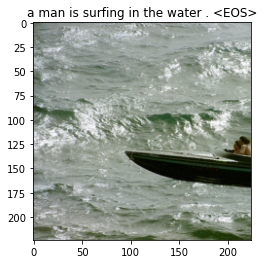

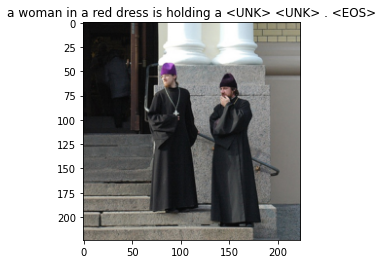

Val visualization: 


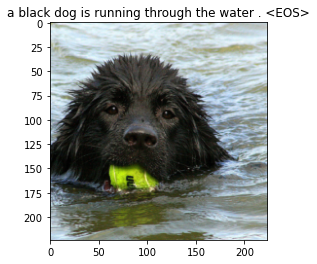

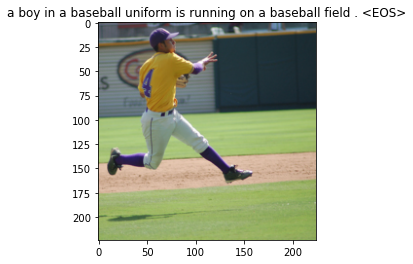

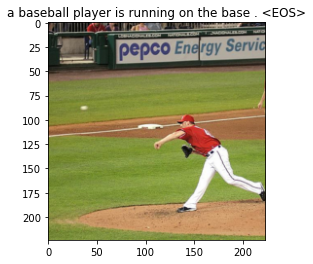

Training Epochs:  40%|████      | 10/25 [33:08<49:42, 198.86s/it]

Epoch: 11  Train_Loss: 2.37836 Val_Loss: 2.69812
Train visualization: 


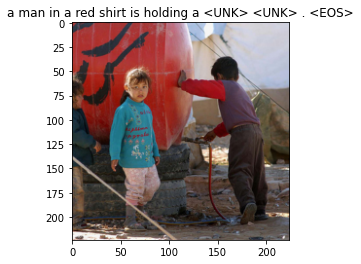

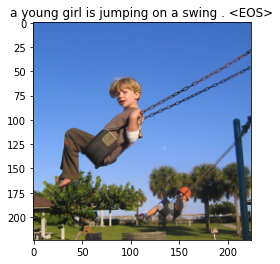

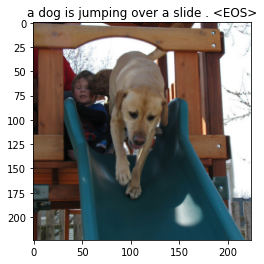

Val visualization: 


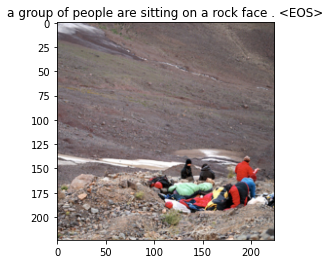

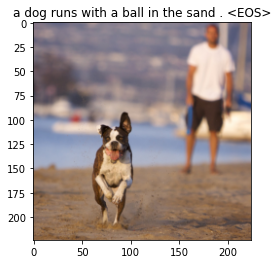

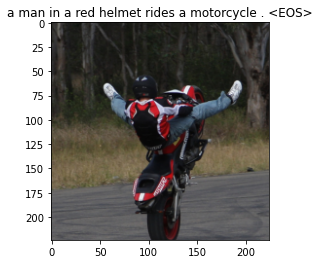

Training Epochs:  44%|████▍     | 11/25 [36:26<46:20, 198.64s/it]

Epoch: 12  Train_Loss: 2.33693 Val_Loss: 2.68314
Train visualization: 


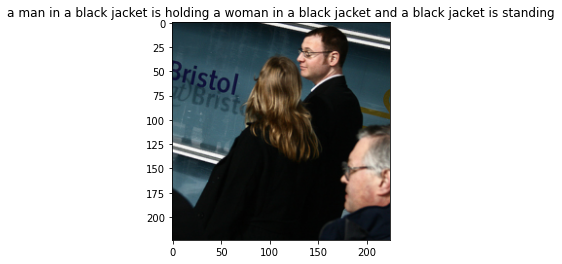

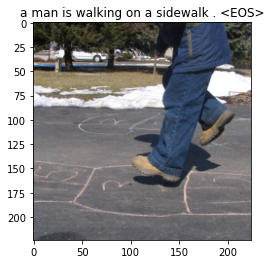

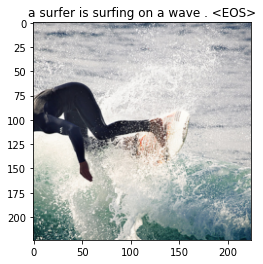

Val visualization: 


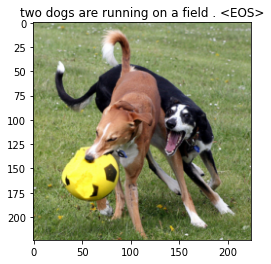

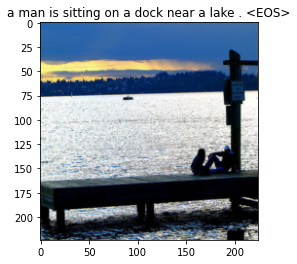

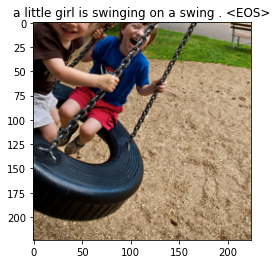

Training Epochs:  48%|████▊     | 12/25 [39:45<43:01, 198.56s/it]

Epoch: 13  Train_Loss: 2.29188 Val_Loss: 2.67117
Train visualization: 


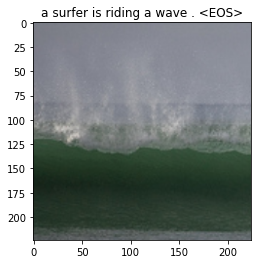

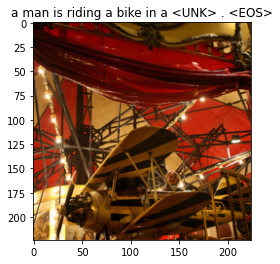

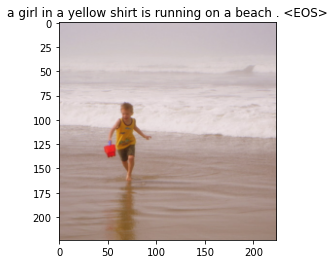

Val visualization: 


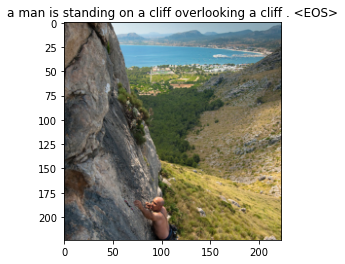

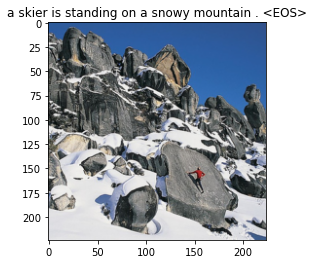

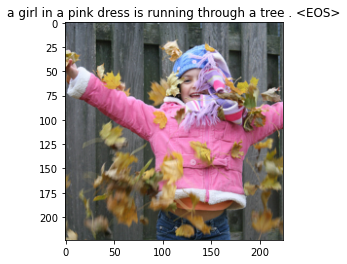

Training Epochs:  52%|█████▏    | 13/25 [43:03<39:42, 198.57s/it]

Epoch: 14  Train_Loss: 2.25241 Val_Loss: 2.66788
Train visualization: 


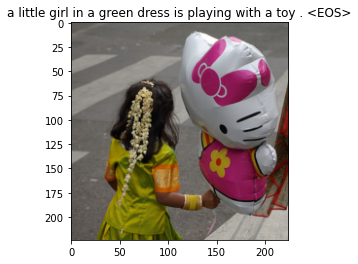

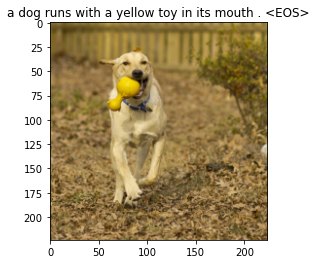

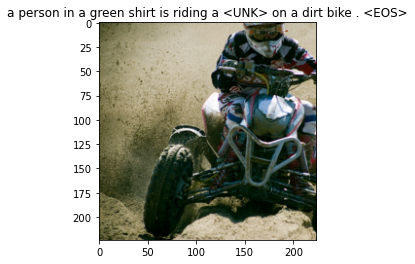

Val visualization: 


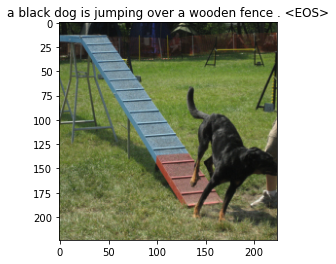

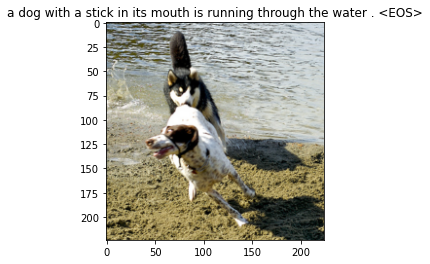

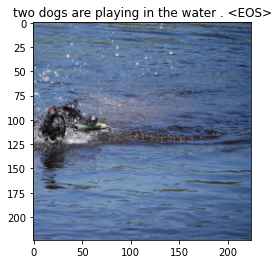

Training Epochs:  56%|█████▌    | 14/25 [46:25<36:35, 199.60s/it]

Epoch: 15  Train_Loss: 2.21485 Val_Loss: 2.66000
Train visualization: 


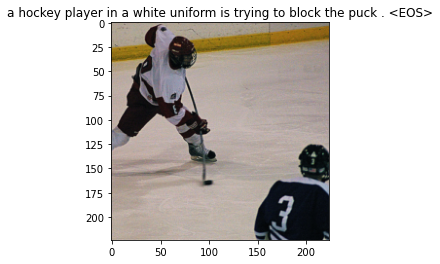

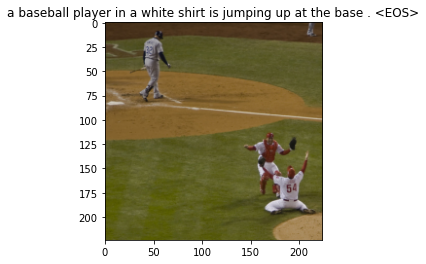

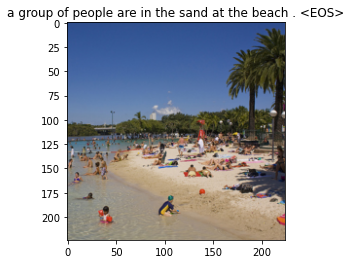

Val visualization: 


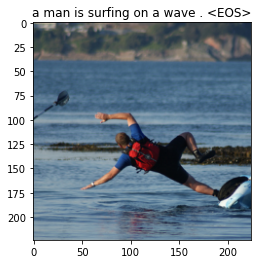

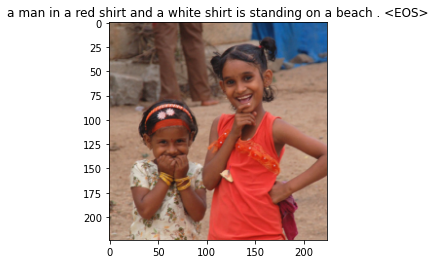

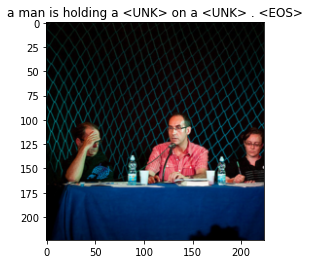

Training Epochs:  60%|██████    | 15/25 [49:48<33:26, 200.61s/it]

Epoch: 16  Train_Loss: 2.17998 Val_Loss: 2.64658
Train visualization: 


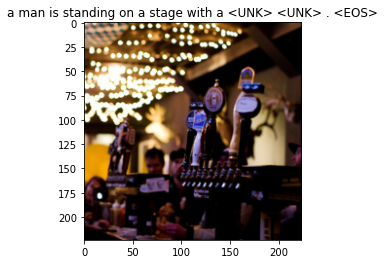

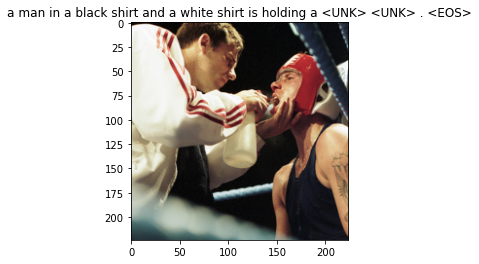

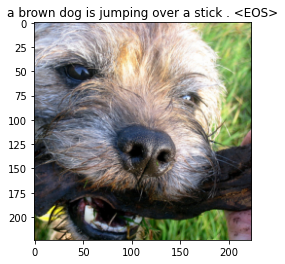

Val visualization: 


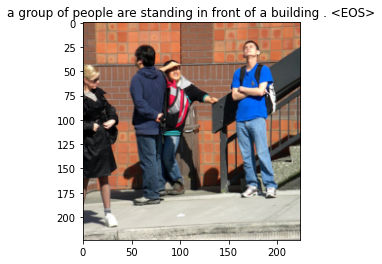

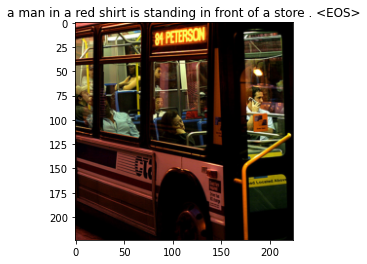

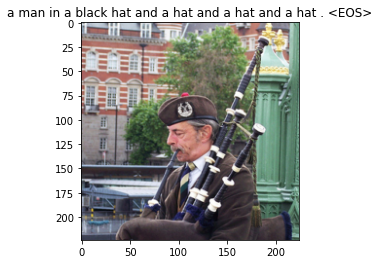

Training Epochs:  64%|██████▍   | 16/25 [53:11<30:12, 201.37s/it]

Epoch: 17  Train_Loss: 2.14770 Val_Loss: 2.64368
Train visualization: 


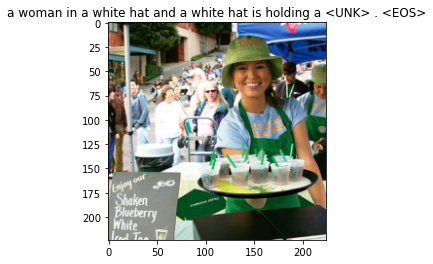

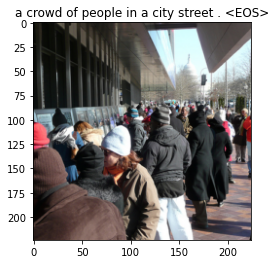

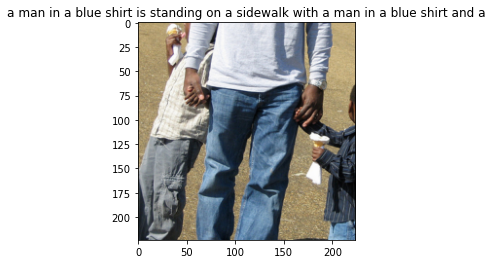

Val visualization: 


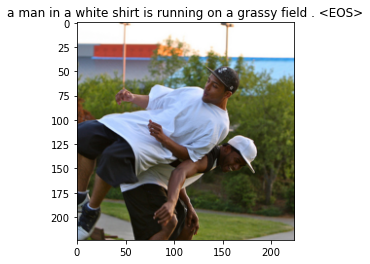

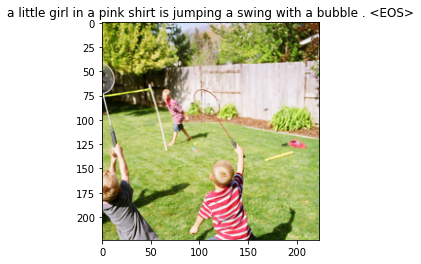

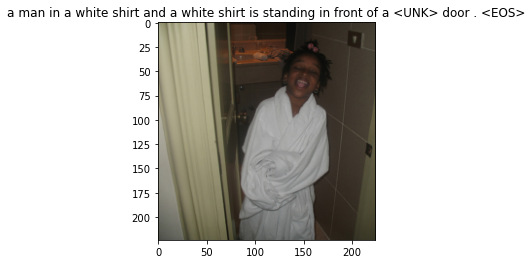

Training Epochs:  68%|██████▊   | 17/25 [56:32<26:48, 201.02s/it]

Epoch: 18  Train_Loss: 2.11562 Val_Loss: 2.63872
Train visualization: 


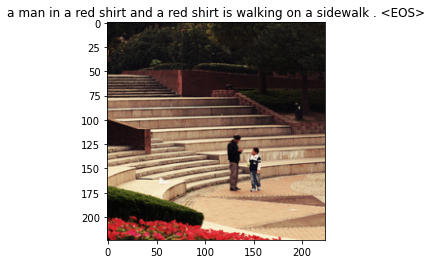

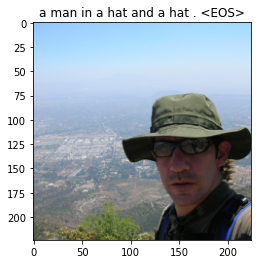

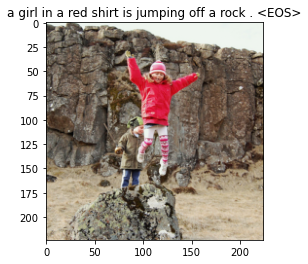

Val visualization: 


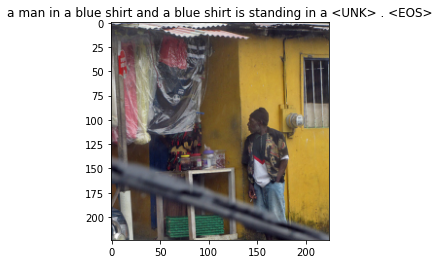

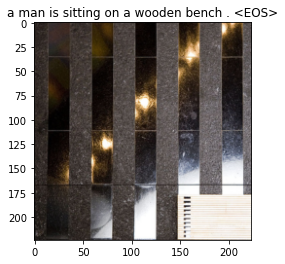

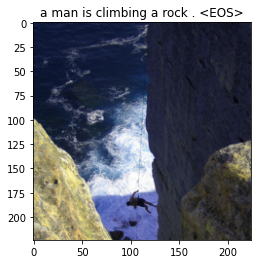

Training Epochs:  72%|███████▏  | 18/25 [59:51<23:22, 200.37s/it]

Epoch: 19  Train_Loss: 2.08458 Val_Loss: 2.63784
Train visualization: 


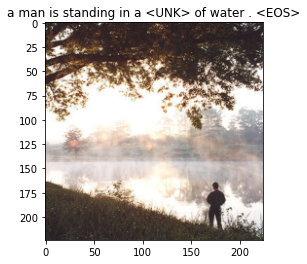

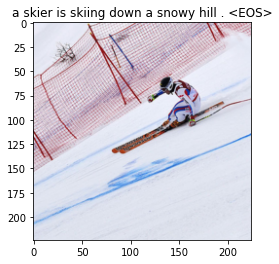

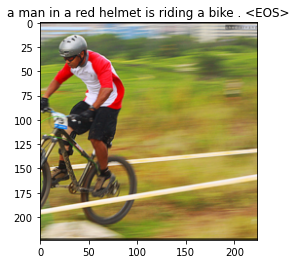

Val visualization: 


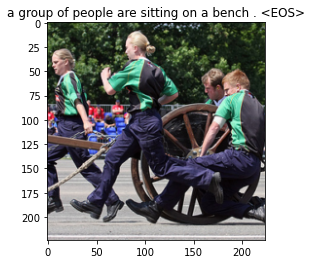

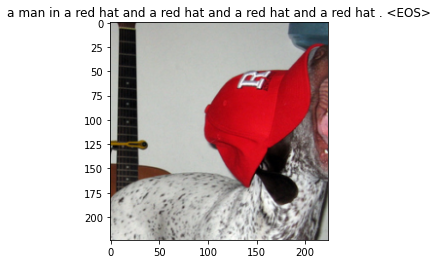

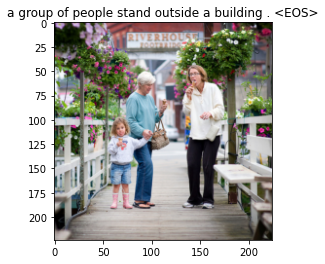

Training Epochs:  76%|███████▌  | 19/25 [1:03:10<20:00, 200.06s/it]

Epoch: 20  Train_Loss: 2.05624 Val_Loss: 2.63530
Train visualization: 


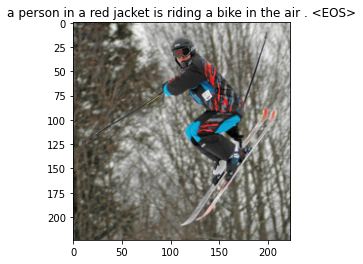

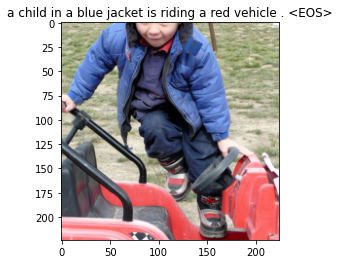

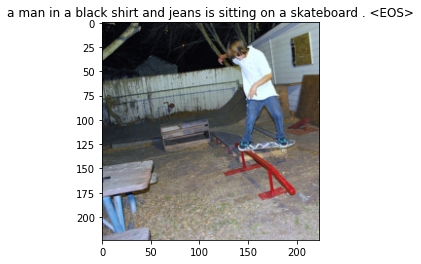

Val visualization: 


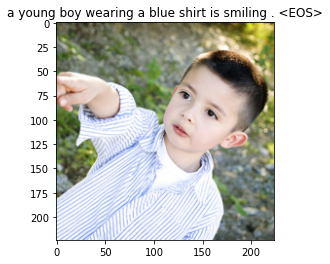

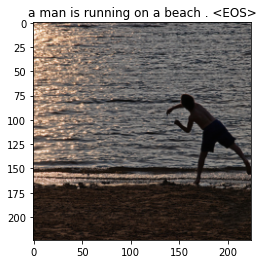

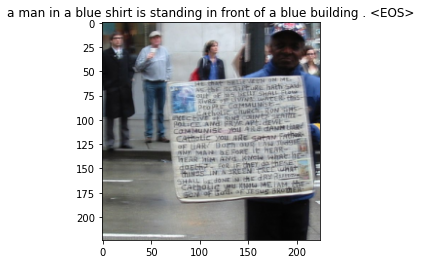

Training Epochs:  80%|████████  | 20/25 [1:06:30<16:40, 200.04s/it]

Epoch: 21  Train_Loss: 2.02636 Val_Loss: 2.63835
Train visualization: 


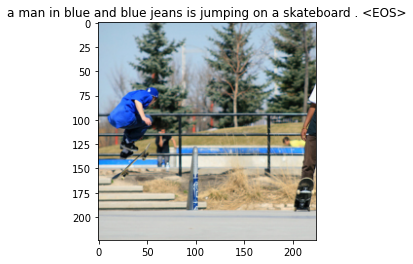

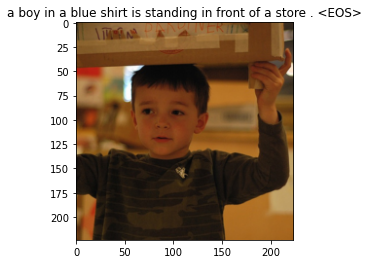

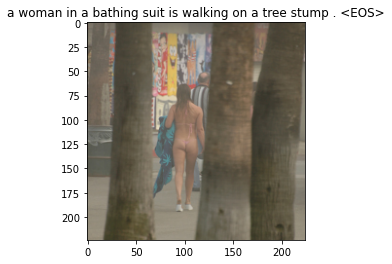

Val visualization: 


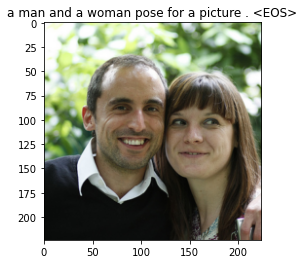

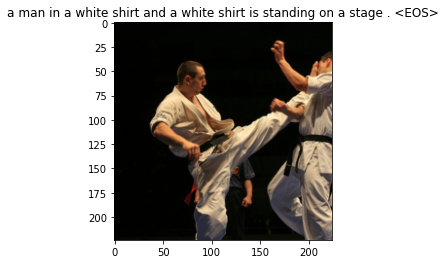

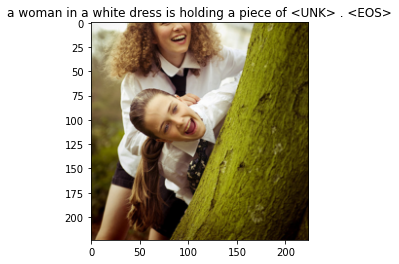

Training Epochs:  84%|████████▍ | 21/25 [1:09:50<13:20, 200.03s/it]

Epoch: 22  Train_Loss: 2.00234 Val_Loss: 2.65131
Train visualization: 


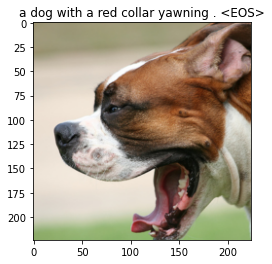

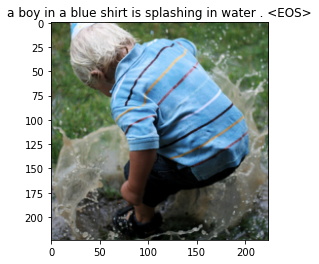

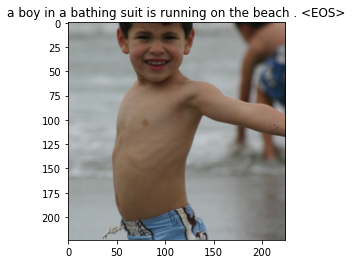

Val visualization: 


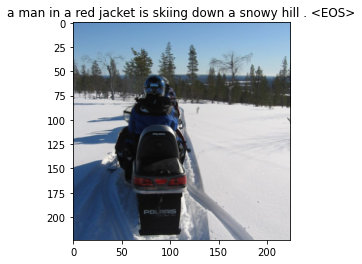

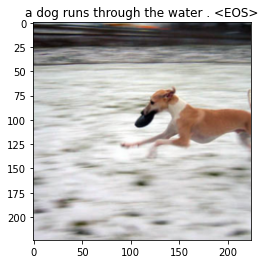

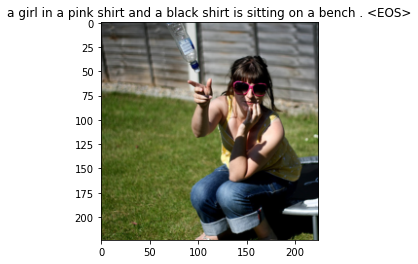

Training Epochs:  88%|████████▊ | 22/25 [1:13:10<10:00, 200.01s/it]

Epoch: 23  Train_Loss: 1.97475 Val_Loss: 2.64540
Train visualization: 


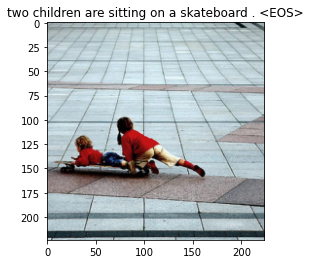

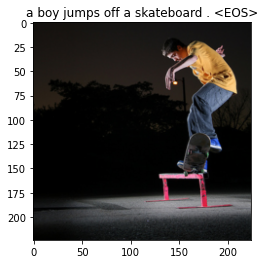

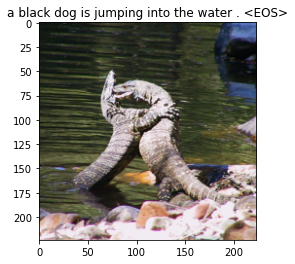

Val visualization: 


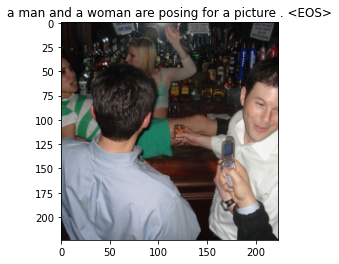

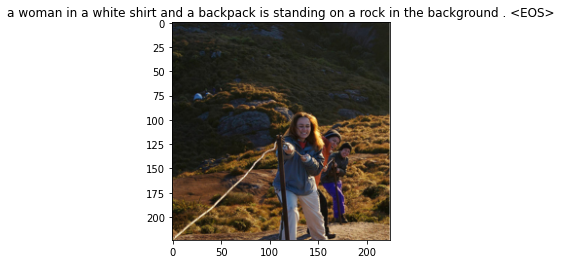

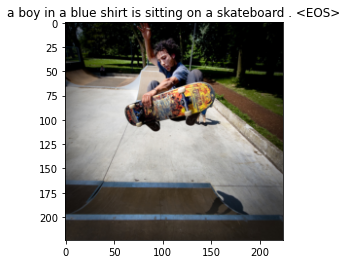

Training Epochs:  92%|█████████▏| 23/25 [1:16:30<06:40, 200.11s/it]

Epoch: 24  Train_Loss: 1.95012 Val_Loss: 2.63643
Train visualization: 


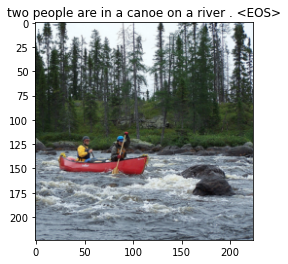

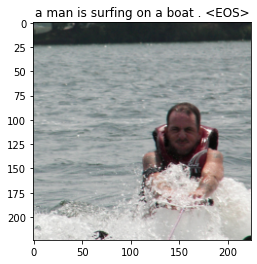

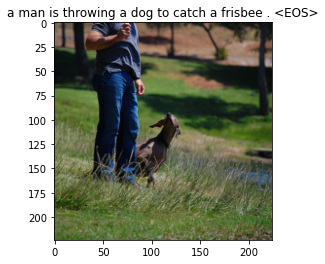

Val visualization: 


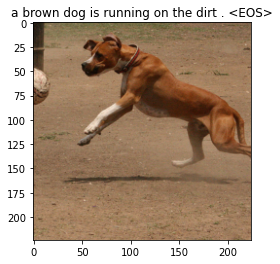

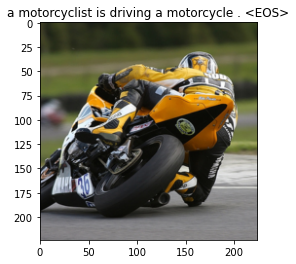

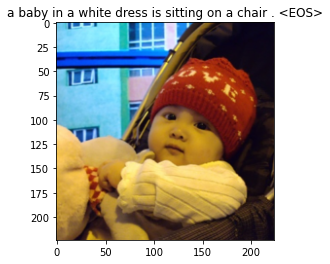

Training Epochs:  96%|█████████▌| 24/25 [1:19:48<03:19, 199.51s/it]

Epoch: 25  Train_Loss: 1.92548 Val_Loss: 2.64362
Train visualization: 


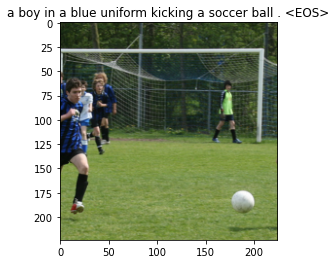

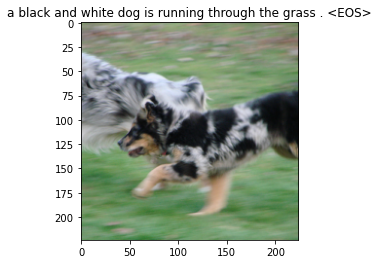

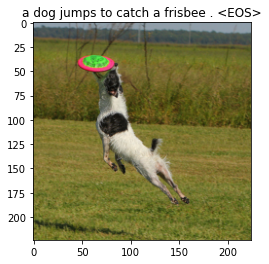

Val visualization: 


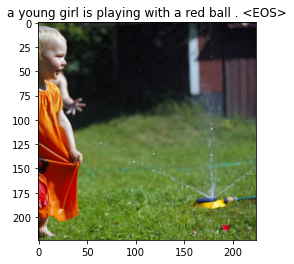

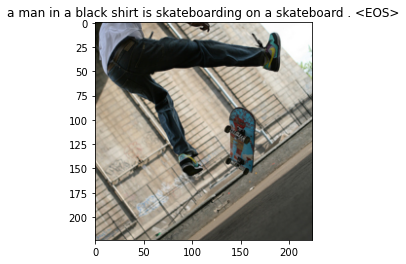

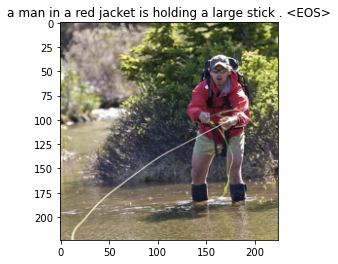

Training Epochs: 100%|██████████| 25/25 [1:23:03<00:00, 199.36s/it]


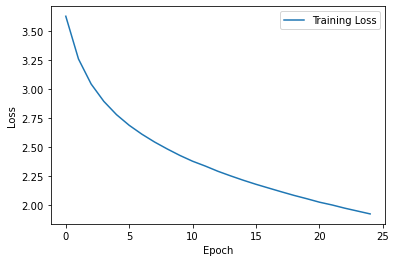

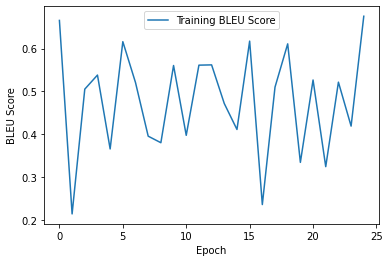

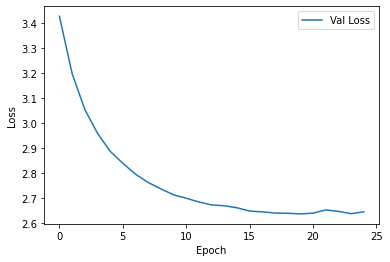

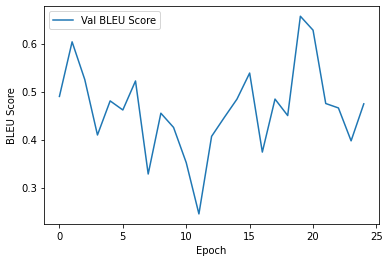

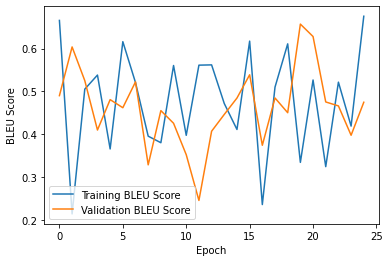

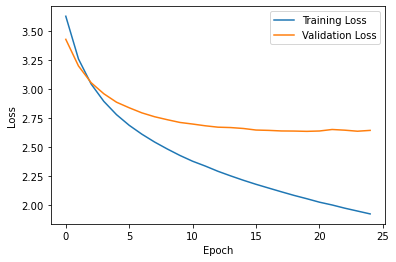

In [40]:
N=3
best_model=train_val_fn(model, train_loader, val_loader, optimizer , criterion, num_epochs=num_epochs, N=N, device=device)

## 6) Visualizing the attentions
Defining helper functions
<li>Given the image generate captions and attention scores</li>
<li>Plot the attention scores in the image</li>

In [53]:
#generate caption
def get_caps_from(features_tensors):
    #generate the caption
    model.eval()
    with torch.no_grad():
        features = model.encoder(features_tensors.to(device))
        caps,alphas = model.decoder.generate_caption(features)
        caption = ' '.join(caps)
        show_image(features_tensors[0],title=caption)
    
    return caps,alphas

#Show attention
from PIL import Image

def plot_attention(img, result, attention_plot,num):
    #untransform
    img[0] = img[0] * 0.229
    img[1] = img[1] * 0.224 
    img[2] = img[2] * 0.225 
    img[0] += 0.485 
    img[1] += 0.456 
    img[2] += 0.406
    
    img = img.numpy().transpose((1, 2, 0))
    img_pil = Image.fromarray((img * 255).astype('uint8'))
    img_pil.save(f'output_image_{num}.png')
    temp_image = img

    fig = plt.figure(figsize=(15, 15))

    len_result = len(result)
    for l in range(len_result):
        temp_att = attention_plot[l].reshape(7,7)
        
        ax = fig.add_subplot(len_result//2,len_result//2, l+1)
        ax.set_title(result[l])
        img = ax.imshow(temp_image)
        ax.imshow(temp_att, cmap='gray', alpha=0.7, extent=img.get_extent())
        

    plt.tight_layout()
    plt.savefig(f'attention_plot_{num}.png')
    
    plt.show()

    
def inference_fn(model,inf_loader,device):
    for num,(imgs, _,ref) in enumerate(inf_loader) : 
        if(num==20):
            break
        img = imgs[0]
        img = img.detach().clone()
        
        img1 = img.detach().clone()
        caps,alphas = get_caps_from(img.unsqueeze(0))
        plot_attention(img1, caps, alphas,num)

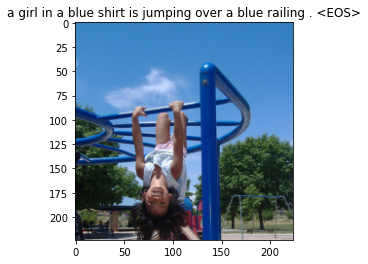

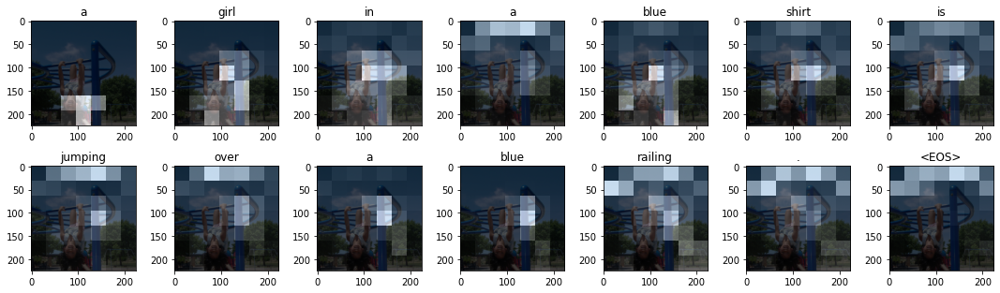

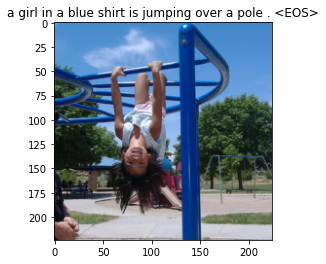

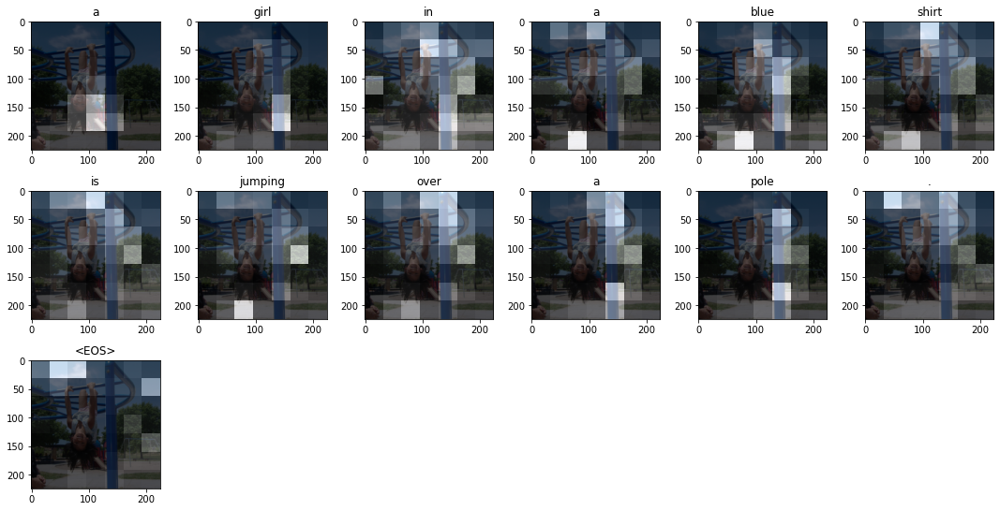

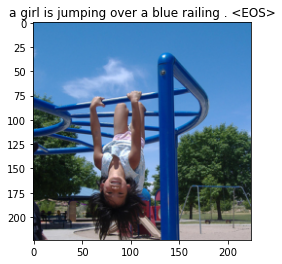

...

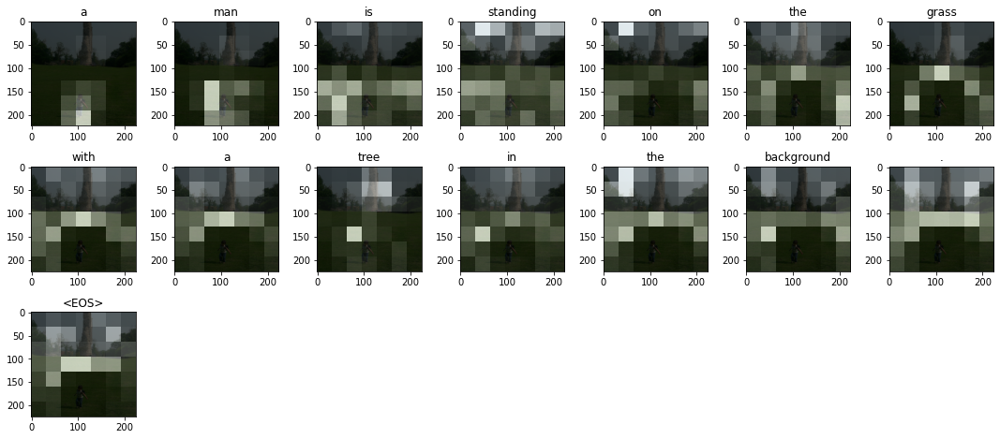

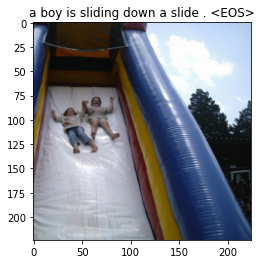

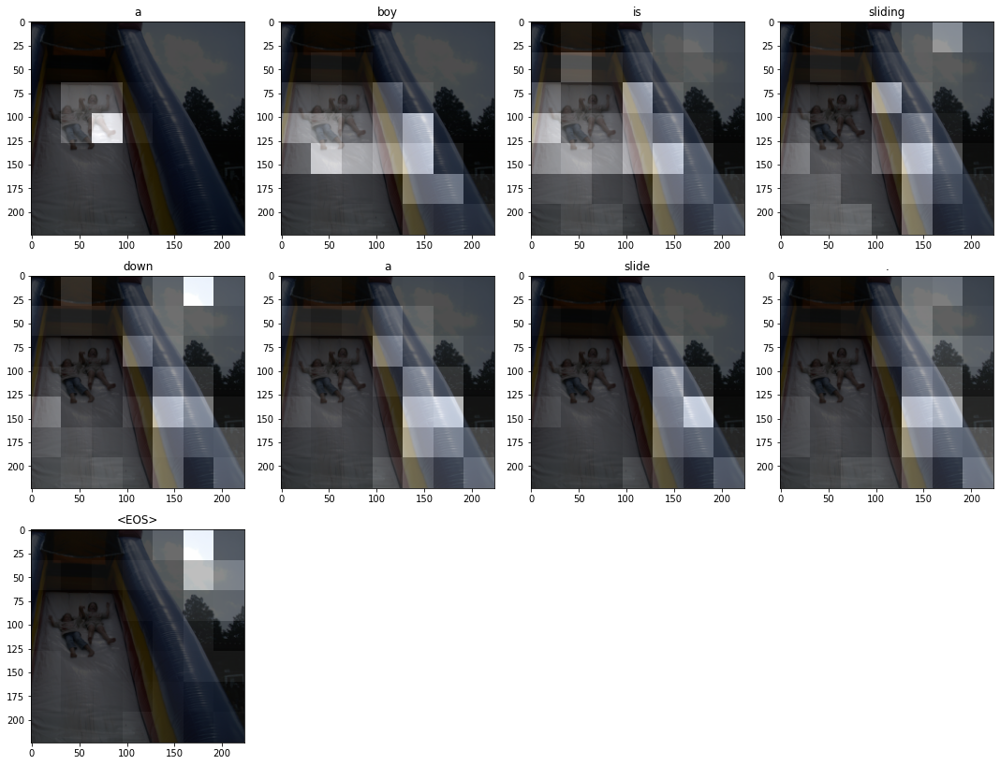

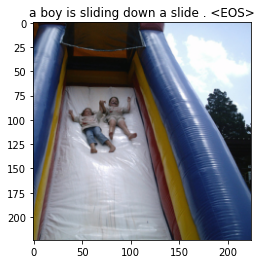

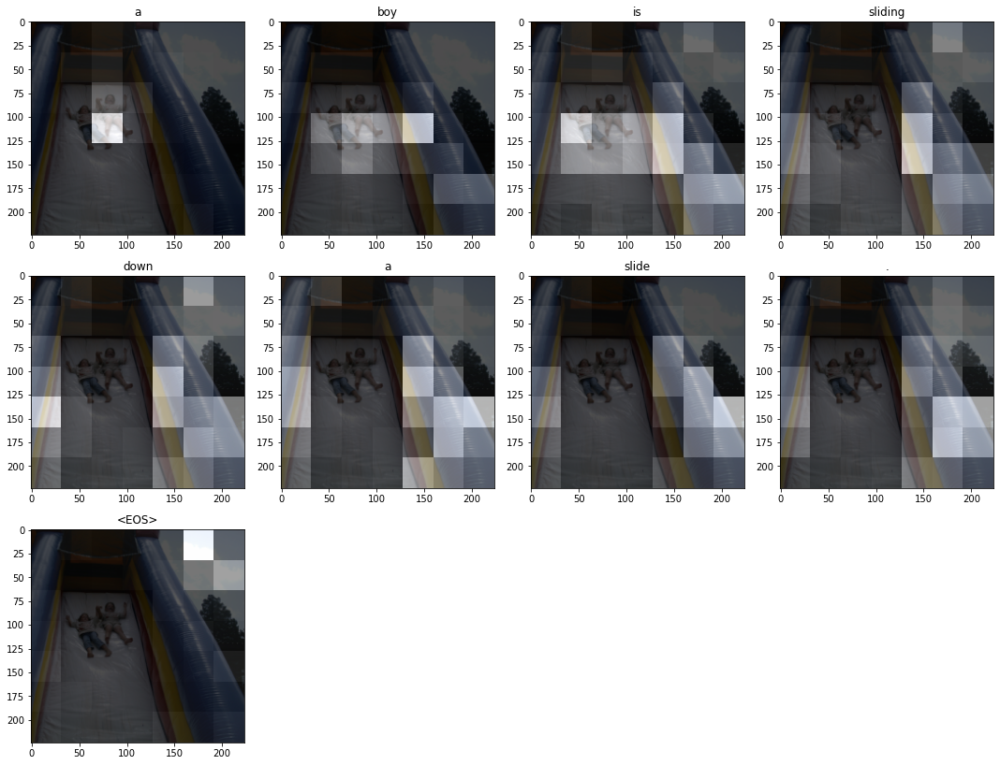

In [54]:
inference_fn(best_model,inf_loader,device)